<div style="width: 100%; height: 100px; background-color: #f1c40f; border: 3px solid #d35400; text-align: center; line-height: 100px; color: #d35400; font-size: 24px; font-weight: bold; border-radius:6px;">
    Diamond Price Prediction 💎| Linear Regression
</div>

<img src="1.jpeg" alt="Photo" style="border-radius: 6px;">

<div style="width: 100%; background-color: #f1c40f; color: white; padding: 20px; border: 3px solid #d35400; margin-bottom: 20px;border-radius:10px;">
    <h3 style="color: #d35400;">Introduction</h3>
    <span >Prediction of numerical value and price is one of the tasks that can be done with regression algorithms. In this netbook, we plan to predict the price of diamonds with the help of the diamond dataset, for this we use these algorithms.
    </span> 
    <h3 style="color: #d35400;">Tasks in this notebook</h3>
    <ul style="list-style-type: none; padding-left: 0;">
        <li><span style="margin-left: -10px;">&#8226;</span> Import libraries</li>
        <li><span style="margin-left: -10px;">&#8226;</span> Read dataset and get information from data</li>
        <li><span style="margin-left: -10px;">&#8226;</span> Cleaning Dataset</li>
        <li><span style="margin-left: -10px;">&#8226;</span> Features</li>
        <li>
            <span style="margin-left: -10px;">&#8226;</span> Modeling
            <ul style="list-style-type: none; padding-left: 20px;">
                <li><span style="margin-left: -10px;">&#8226;</span> Linear Regression</li>
                <li><span style="margin-left: -10px;">&#8226;</span> KNeighbors Regressor</li>
                <li><span style="margin-left: -10px;">&#8226;</span> Decision Tree Regressor</li>
            </ul>
        </li>
        <li><span style="margin-left: -10px;">&#8226;</span>Compare prediction with real values</li>
    </ul>
</div>


<h2 style="position: relative;">
    <span style="color: #d35400;">Dataset Overview</span> 
    <br/>
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>


<center>
<div dir=rtl style="direction: rtl;line-height:200%;font-family:vazir;font-size:medium">
<font face="vazir" size=3>
    
|Description|Column|
|:------:|:--------:|
|Diamond weight in carat|<code>carat</code>|
|diamond cutting quality|<code>cut</code>|
|diamond color from J (worst) to D (best)|<code>color</code>|
|A measure of diamond clarity <i>(from left to right is worst to best: I1, SI2, SI1, VS2, VS1, VVS2, VVS1, IF)<i/>|<code>clarity</code>|
|diamond length in mm|<code>x</code>|
|diamond width in mm|<code>y</code>|
|diamond depth in mm|<code>z</code>|
|Percentage depth that is equal to z / mean(x,y)|<code>depth</code>|
|The width of the widest point at the top of the diamond|<code>table</code>|
|diamond price|<code><b>price [target variable]</b></code>|

</font>
</div>
</center>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">1.</span> 
    <span style="color: #d35400;">Libraries and Warnings</span> 
    <br/>
</h2>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">1.1</span> 
    <span style="color: #d35400;">Import Libraries</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>


In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split , GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor

<h2 style="position: relative;">
    <span style="color: #f1c40f;">1.2</span> 
    <span style="color: #d35400;">Ignore warnings</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

<h2 style="position: relative;">
    <span style="color: #f1c40f;">2.</span> 
    <span style="color: #d35400;">Read dataset and get information from data</span> 
    <br/>
</h2>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">2.1</span> 
    <span style="color: #d35400;">Read Dataset</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [4]:
df = pd.read_csv('data/diamonds.csv')

In [5]:
df.head(3)

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31


<h2 style="position: relative;">
    <span style="color: #f1c40f;">2.2</span> 
    <span style="color: #d35400;">Dataset Shape</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [6]:
row, col = df.shape
print("This Dataset have",row,"rows and",col,"columns.")

This Dataset have 50000 rows and 10 columns.


<h2 style="position: relative;">
    <span style="color: #f1c40f;">2.3</span> 
    <span style="color: #d35400;">Checking Duplicates and drop them</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [7]:
print("Number of duplicate data : ",df.duplicated().sum())

Number of duplicate data :  126


In [8]:
df = df.drop_duplicates()

In [9]:
row, col = df.shape
print("This Dataset have",row,"rows and",col,"columns.")

This Dataset have 49874 rows and 10 columns.


<h2 style="position: relative;">
    <span style="color: #f1c40f;">2.4</span> 
    <span style="color: #d35400;">Information about Dataset</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49874 entries, 0 to 49999
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    49874 non-null  float64
 1   cut      49874 non-null  object 
 2   color    49874 non-null  object 
 3   clarity  49874 non-null  object 
 4   depth    49874 non-null  float64
 5   table    49874 non-null  float64
 6   price    49874 non-null  int64  
 7   x        49874 non-null  float64
 8   y        49874 non-null  float64
 9   z        49874 non-null  float64
dtypes: float64(6), int64(1), object(3)
memory usage: 4.2+ MB


In [11]:
df.describe()

,carat,depth,table,price,x,y,z
count,49874.000000,49874.000000,49874.000000,49874.000000,49874.000000,49874.000000,49874.000000
mean,0.799331,61.751803,57.458786,3945.384569,5.734441,5.738060,3.541028
std,0.474607,1.428207,2.231087,3996.939331,1.122340,1.144973,0.706607
min,0.200000,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,0.400000,61.000000,56.000000,952.000000,4.720000,4.720000,2.910000
50%,0.700000,61.800000,57.000000,2414.000000,5.700000,5.710000,3.530000
75%,1.040000,62.500000,59.000000,5352.000000,6.540000,6.540000,4.040000
max,5.010000,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000


In [12]:
df.describe(include = "object")

,cut,color,clarity
count,49874,49874,49874
unique,5,7,8
top,Ideal,G,SI1
freq,19881,10424,12086


<h2 style="position: relative;">
    <span style="color: #f1c40f;">3.</span> 
    <span style="color: #d35400;">Cleaning Data</span> 
    <br/>
</h2>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">3.1</span> 
    <span style="color: #d35400;">Checking missing values</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [13]:
df.isna().sum()

carat      0
cut        0
color      0
clarity    0
depth      0
table      0
price      0
x          0
y          0
z          0
dtype: int64

<h4 style="position: relative;">
    <span style="color: #d35400;">
    Look we do not have missing values!🥳
    </span> 
</h4>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">3.2</span> 
    <span style="color: #d35400;">Dropping not acceptable negative values</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

<h4 style="position: relative;">
    <span style="color: #d35400;">
    x, y and z are length so they can't be less or equal than zero
    </span> 
</h4>

In [14]:
df = df.loc[~(((df['x'] <= 0) | (df['y'] <= 0)) | (df['z'] <= 0))]

<h2 style="position: relative;">
    <span style="color: #f1c40f;">3.3</span> 
    <span style="color: #d35400;">Checking value counts in plots</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [15]:
px.histogram(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='cut', facet_col='color', color='cut', title='Cut Counts By Each Color', color_discrete_sequence=px.colors.qualitative.Pastel)

In [16]:
px.histogram(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='clarity', facet_col='color', color='clarity', title='Clarity By Each Color', color_discrete_sequence=px.colors.qualitative.Pastel)

<h2 style="position: relative;">
    <span style="color: #f1c40f;">3.4</span> 
    <span style="color: #d35400;"> Checking Noise and Outliers and dropping them</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [17]:
px.scatter(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='carat', color='carat',y='price')

In [18]:
px.scatter(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='depth', color='depth', y='price')

In [19]:
px.scatter(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='table', color='table', y='price')

In [20]:
px.scatter(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='x', y='price', color='x')

In [21]:
px.scatter(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='y', y='price', color='y')

In [22]:
px.scatter(df.sample(n=10000, replace=False, random_state=123).sort_index(), x='z', y='price', color='z')

In [23]:
fig = px.scatter_matrix(df, dimensions=['carat','depth','table','x','y','z','price'])
fig.update_layout(title='Pairplot', title_font=dict(size=25))
fig.show()

In [24]:
df = df.loc[~(((df['y'] > 30) | (df['z'] > 30)) | (df['table'] > 94))]

<h2 style="position: relative;">
    <span style="color: #f1c40f;">3.5</span> 
    <span style="color: #d35400;"> Correlation Matrix</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [25]:
df_corr = df.corr()

fig = px.imshow(df_corr,
                labels=dict(x="Features", y="Features"),
                x=df_corr.columns,
                y=df_corr.columns,
                color_continuous_scale="Blues",
                color_continuous_midpoint=0)

fig.update_layout(
    title="Correlation Heatmap",
    width=800,
    height=500,
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    yaxis_autorange='reversed')

fig.show()

<h2 style="position: relative;">
    <span style="color: #f1c40f;">4.</span> 
    <span style="color: #d35400;"> Features</span> 
    <br/>
</h2>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">4.1</span> 
    <span style="color: #d35400;"> Combining x, y, z due to high correlation and dropping them</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [26]:
df['xyz'] = df['x']*df['y']*df['z']

In [27]:
df.drop(columns=['x','y','z'], axis=1, inplace=True)

<h2 style="position: relative;">
    <span style="color: #f1c40f;">4.2</span> 
    <span style="color: #d35400;"> mapping categorical columns</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

In [28]:
print(df.cut.unique())

['Ideal' 'Premium' 'Good' 'Very Good' 'Fair']


In [29]:
cut_encodeing = {
    "Fair" : 0,
    "Good" : 1,
    "Very Good" : 2,
    "Premium" : 3,
    "Ideal" : 4,
}

df['cut'].replace(cut_encodeing, inplace=True)

In [30]:
print(df.color.unique())

['E' 'I' 'J' 'H' 'F' 'G' 'D']


In [31]:
color_encodeing = {
    "D" : 6,
    "E" : 5,
    "F" : 4,
    "G" : 3,
    "H" : 2,
    "I" : 1,
    "J" : 0,
}

df['color'].replace(color_encodeing, inplace=True)

In [32]:
print(df.clarity.unique())

['SI2' 'SI1' 'VS1' 'VS2' 'VVS2' 'VVS1' 'I1' 'IF']


In [33]:
clarity_encodeing = {
    "I1" : 0,
    "SI2" : 1,
    "SI1" : 2,
    "VS2" : 3,
    "VS1" : 4,
    "VVS2" : 5,
    "VVS1" : 6,
    "IF" : 7,
}

df['clarity'].replace(clarity_encodeing, inplace=True)

<h2 style="position: relative;">
    <span style="color: #f1c40f;">5.</span> 
    <span style="color: #d35400;"> Modeling</span> 
    <br/>
</h2>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">5.1</span> 
    <span style="color: #d35400;"> Linear Regression</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.1.1</span> 
    <span style="color: #d35400;"> Finding best test size and random state</span> 
    <br/>
    <br/>
</h4>

In [34]:
model = LinearRegression()

test_sizes = [0.1, 0.15, 0.2, 0.3]
random_states = [0, 1, 42, 43, 100, 313]

best_test_size = None
best_random_state = None
best_r2_score = -float('inf')

for test_size in test_sizes:
    for random_state in random_states:
        X_train, X_test, y_train, y_test = train_test_split(df.drop('price', axis=1), df.price, test_size=test_size, random_state=random_state)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        r2 = r2_score(y_test, y_pred)
        if r2 > best_r2_score:
            best_r2_score = r2
            best_test_size = test_size
            best_random_state = random_state

print(f"Best test size: {best_test_size}")
print(f"Best random state: {best_random_state}")
print(f"Best R2 score: {best_r2_score}")

Best test size: 0.1
Best random state: 100
Best R2 score: 0.9141736272442125


<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.1.2</span> 
    <span style="color: #d35400;"> Creating Final Linear Regression Model</span> 
    <br/>
    <br/>
</h4>

In [35]:
X_train, X_test , y_train, y_test = train_test_split(df.drop('price', axis=1), df.price, test_size=.1, random_state=100)

LRmodel = LinearRegression(fit_intercept=True)
LRmodel.fit(X_train, y_train)

LinearRegression()

<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.1.3</span> 
    <span style="color: #d35400;"> Model evaluation using r2 Score</span> 
    <br/>
    <br/>
</h4>

In [36]:
y_pred = LRmodel.predict(X_test)
r2_score(y_test, y_pred)

0.9141736272442125

<h2 style="position: relative;">
    <span style="color: #f1c40f;">5.2</span> 
    <span style="color: #d35400;"> KNearest Neighbors Regression</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.2.1</span> 
    <span style="color: #d35400;"> Finding best test size and random state</span> 
    <br/>
    <br/>
</h4>

In [37]:
model = KNeighborsRegressor()

test_sizes = [0.1, 0.15, 0.2, 0.3]
random_states = [0, 1, 42, 43, 100, 313]

best_test_size = None
best_random_state = None
best_r2_score = -float('inf')

for test_size in test_sizes:
    for random_state in random_states:
        X_train, X_test, y_train, y_test = train_test_split(df.drop('price', axis=1), df.price, test_size=test_size, random_state=random_state)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        r2 = r2_score(y_test, y_pred)
        if r2 > best_r2_score:
            best_r2_score = r2
            best_test_size = test_size
            best_random_state = random_state

print(f"Best test size: {best_test_size}")
print(f"Best random state: {best_random_state}")
print(f"Best R2 score: {best_r2_score}")

Best test size: 0.1
Best random state: 100
Best R2 score: 0.9638426630490462


<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.2.2</span> 
    <span style="color: #d35400;"> Finding best hyperparameters using GridSearchCV</span> 
    <br/>
    <br/>
</h4>

In [38]:
X_train, X_test, y_train, y_test = train_test_split(df.drop('price', axis=1), df.price, test_size=0.1, random_state=100)

KNNmodel = KNeighborsRegressor()

param_grid = {
    'n_neighbors': range(3,11,2),
    'weights': ['uniform', 'distance'],
    'p': [1, 2]
}

grid_search = GridSearchCV(estimator=KNNmodel, param_grid=param_grid, scoring='r2', cv=5)
grid_search.fit(X_train, y_train)

best_r2_score = grid_search.best_score_
best_params = grid_search.best_params_
print(f"Best R2 score: {best_r2_score}")
print(f"Best hyperparameters: {best_params}")

best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
test_r2 = r2_score(y_test, y_pred)
print(f"R2 score on test set: {test_r2}")

Best R2 score: 0.9648279627974746
Best hyperparameters: {'n_neighbors': 9, 'p': 1, 'weights': 'distance'}
R2 score on test set: 0.9702575529491448


<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.2.3</span> 
    <span style="color: #d35400;"> Creating final KNN Regressor Model</span> 
    <br/>
    <br/>
</h4>

In [39]:
KNNmodel = KNeighborsRegressor(**best_params)
KNNmodel.fit(X_train, y_train)

KNeighborsRegressor(n_neighbors=9, p=1, weights='distance')

<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.2.4</span> 
    <span style="color: #d35400;"> Model evaluation using r2 Score</span> 
    <br/>
    <br/>
</h4>

In [40]:
y_pred = KNNmodel.predict(X_test)
r2_score(y_test, y_pred)

0.9702575529491448

<h2 style="position: relative;">
    <span style="color: #f1c40f;">5.3</span> 
    <span style="color: #d35400;"> Decision Tree Regressor</span> 
    <br/>
    <br/>
    <hr style="position: absolute; bottom: -8px; border: none; height: 4px; width: 100%; background-color: #f1c40f;">
</h2>

<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.3.1</span> 
    <span style="color: #d35400;"> Finding best test size and random state</span> 
    <br/>
    <br/>
</h4>

In [41]:
model = DecisionTreeRegressor()

test_sizes = [0.1, 0.15, 0.2, 0.3]
random_states = [0, 1, 42, 43, 100, 313]

best_test_size = None
best_random_state = None
best_r2_score = -float('inf')

for test_size in test_sizes:
    for random_state in random_states:
        X_train, X_test, y_train, y_test = train_test_split(df.drop('price', axis=1), df.price, test_size=test_size, random_state=random_state)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        r2 = r2_score(y_test, y_pred)
        if r2 > best_r2_score:
            best_r2_score = r2
            best_test_size = test_size
            best_random_state = random_state

print(f"Best test size: {best_test_size}")
print(f"Best random state: {best_random_state}")
print(f"Best R2 score: {best_r2_score}")

Best test size: 0.1
Best random state: 100
Best R2 score: 0.9710570179388586


<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.3.2</span> 
    <span style="color: #d35400;"> Finding best hyperparameters using GridSearchCV</span> 
    <br/>
    <br/>
</h4>

In [42]:
X_train, X_test, y_train, y_test = train_test_split(df.drop('price', axis=1), df.price, test_size=0.1, random_state=100)

DTRmodel = DecisionTreeRegressor()
cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')

param_grid = {
    'max_depth': [None, 5, 10, 15, 20],
    'min_samples_split': [15, 20, 25, 30, 35],
    'min_samples_leaf': [1, 2, 4, 6, 8, 10]
}

grid_search = GridSearchCV(estimator=DTRmodel, param_grid=param_grid, scoring='r2', cv=5)
grid_search.fit(X_train, y_train)

best_r2_score = grid_search.best_score_
best_params = grid_search.best_params_
print(f"Best R2 score: {best_r2_score}")
print(f"Best hyperparameters: {best_params}")

best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)
test_r2 = r2_score(y_test, y_pred)
print(f"R2 score on test set: {test_r2}")

Best R2 score: 0.9762395721451893
Best hyperparameters: {'max_depth': 15, 'min_samples_leaf': 8, 'min_samples_split': 25}
R2 score on test set: 0.9797806097881437


<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.3.3</span> 
    <span style="color: #d35400;"> Creating final DT Regressor Model</span> 
    <br/>
    <br/>
</h4>

In [43]:
DTRmodel = DecisionTreeRegressor(**best_params)
DTRmodel.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=15, min_samples_leaf=8, min_samples_split=25)

<h4 style="position: relative;">
    <span style="color: #f1c40f;">5.3.4</span> 
    <span style="color: #d35400;"> Model evaluation using r2 Score</span> 
    <br/>
    <br/>
</h4>

In [44]:
y_pred = DTRmodel.predict(X_test)
r2_score(y_test, y_pred)

0.9797779764109821

<div style="width: 100%; height: 100px; background-color: #f1d407; border: 3px solid #d35400; text-align: center; line-height: 100px; color: #d35400; font-size: 24px; font-weight: bold; border-radius:6px;">
    By improving our model we reached 98% accuracy 🏆
</div>

<h2 style="position: relative;">
    <span style="color: #f1c40f;">5.</span> 
    <span style="color: #d35400;"> Visualizing prediction</span> 
    <br/>
</h2>

In [45]:
y_final = best_model.predict(df.drop('price', axis=1))
comparison_df = pd.DataFrame({'Actual Price': df.price, 'Predicted Price': y_final})

fig = px.scatter(comparison_df, x='Actual Price', y='Predicted Price', color='Actual Price')
fig.update_layout(
    title='Comparison of Actual Price vs. Predicted Price',
    xaxis_title='Actual Price',
    yaxis_title='Predicted Price'
)
fig.show()

In [46]:
mse_df = comparison_df.groupby('Actual Price').mean().reset_index()
mse_df['MSE'] = np.square(mse_df['Actual Price'] - mse_df['Predicted Price'])

fig = px.scatter(comparison_df, x='Actual Price', y='Predicted Price', color='Actual Price', opacity=0.6,
                color_continuous_scale='Viridis')
fig.add_scatter(x=mse_df['Actual Price'], y=mse_df['Predicted Price'], mode='lines', name='MSE',
                line=dict(color='red', width=2))
fig.update_layout(
    title='Comparison of Actual Price vs. Predicted Price and MSE ',
    xaxis_title='Actual Price',
    yaxis_title='Predicted Price'
)
fig.show()

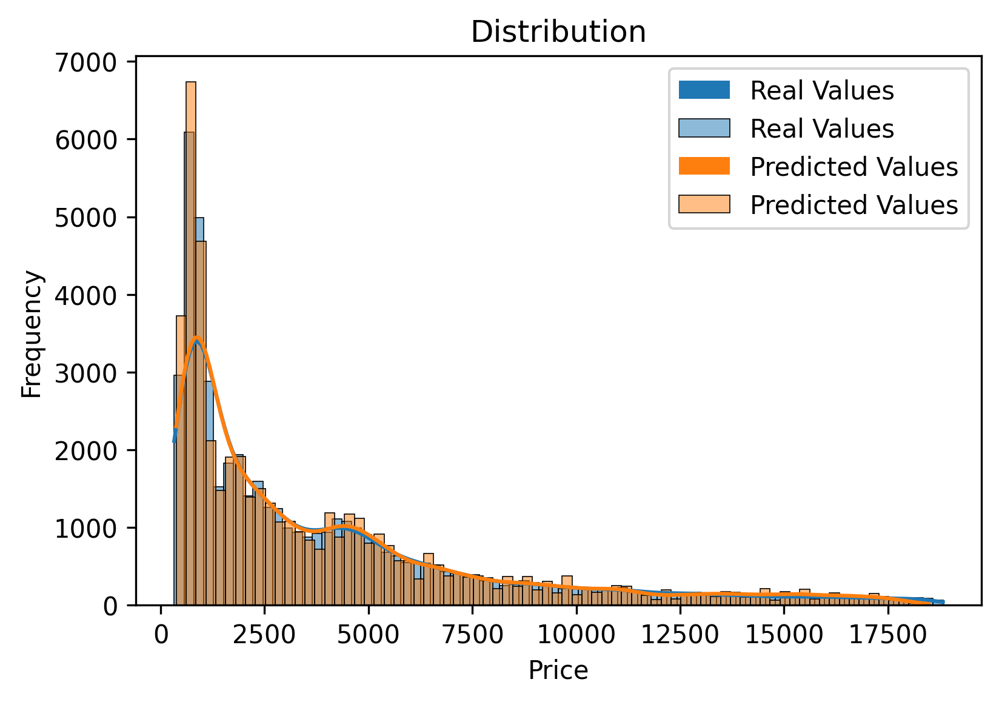

In [47]:
plt.figure(dpi=300)
sns.histplot(df.price, kde=True, label='Real Values')
sns.histplot(y_final, kde=True, label='Predicted Values')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Distribution')
plt.legend()
plt.show();

<div style="width: 100%; height: 100px; background-color: #f1d407; border: 3px solid #d35400; text-align: center; line-height: 100px; color: #d35400; font-size: 24px; font-weight: bold; border-radius:6px;">
    Thanks for paying attention to this notebook
</div>